In [ ]:
# 在时间戳列上基于预测的查找

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
def predictSearch(array, data, opeNum):
    opeNum += 1
    # array是有序数组，data是我们要找的值，最后返回data值对应的index
    minData = array[0]
    maxData = array[-1]
    predictIndex = int((data - minData) / (maxData - minData) * (len(array) - 1))
    predictData = array[predictIndex]
    print("data: ", array)
    print("predictIndex: ", predictIndex)
    if predictData == data:
        return predictIndex, opeNum
    elif predictData < data:
        return predictSearch(array[predictIndex+1:], data, opeNum)
    else:
        return predictSearch(array[:predictIndex], data, opeNum)
        


In [36]:
def compressPredictSearch(array, data, opeNum):
    if data== array[0]:
        return 0, opeNum
    if data == array[-1]:
        return len(array)-1, opeNum
    if len(array)==2:
        return -1, opeNum
    opeNum += 1
    # array是有序数组，data是我们要找的值，最后返回data值对应的index
    minData = array[0]
    maxData = array[-1]
    predictIndex = int((data - minData) / (maxData - minData) * (len(array) - 1))
    if predictIndex==0:
        predictIndex=1
    predictData = array[predictIndex]
    #print("data: ", array)
    print("predictIndex: ", predictIndex, "predictValue:", array[predictIndex])
    if predictData == data:
        return predictIndex, opeNum
    elif predictData < data:
        return compressPredictSearch(array[predictIndex:], data, opeNum)
    else:
        return compressPredictSearch(array[:predictIndex+1], data, opeNum)

In [32]:
def binarySearch(array, data):
    # array是有序数组，data是我们要找的值，最后返回data值对应的index
    left = 0
    right = len(array) - 1
    opeNum = 0
    while left <= right:
        mid = (left + right) // 2
        midData = array[mid]
        print("midIndex: ", mid)
        opeNum += 1
        if midData == data:
            return mid, opeNum
        elif midData < data:
            left = mid + 1
        else:
            right = mid - 1
    
    return -1, opeNum  # 如果没有找到data，返回-1

In [20]:
# 生成从 1 到 20 的数组
x = np.arange(1, 11)

# 计算每个元素的平方
y = x * x

In [19]:
print("y: ", y)
compressPredictSearch(y,16, 0)
binarySearch(y, 49)

y:  [0, 1, 2, 20, 50, 70, 90, 98, 99, 100, 101]
predictIndex:  1 predictValue: 1
predictIndex:  1 predictValue: 2
predictIndex:  1 predictValue: 20
midIndex:  5
midIndex:  2
midIndex:  3
midIndex:  4


NameError: name 'oepNum' is not defined

1407240416501.0
1407240416720.0
1407240416911.0
1407240417111.0
[1.40724042e+12 1.40724042e+12 1.40724042e+12 ... 1.40730130e+12
 1.40730130e+12 1.40730130e+12]


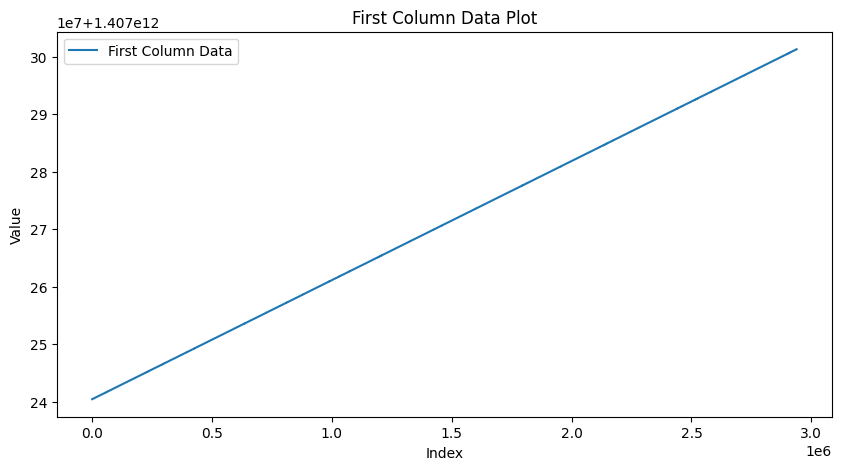

In [30]:
# 从csv文件中读取时间序列数据
#filePath = "D:/senior/DQ/research/compress_find/dataset/data1/bar+crawl+detecting+heavy+drinking/data/all_accelerometer_data_pids_13.csv"
filePath = "D:/senior/DQ/research/compress_find/dataset/samsung/s-10_cleaned_new.csv"
df = pd.read_csv(filePath, skiprows=2)
first_column = df.iloc[:, 0]
print(first_column[0])
print(first_column[1])

print(first_column[2])
print(first_column[3])

first_column_np = np.array(first_column)
print(first_column_np)
np.sort(first_column_np)

plt.figure(figsize=(10, 5))

# 绘制 first_column 数据
plt.plot(first_column, label='First Column Data')

# 添加标题和标签
plt.title('First Column Data Plot')
plt.xlabel('Index')
plt.ylabel('Value')

# 添加图例
plt.legend()

# 显示图表
plt.show()

In [39]:
binarys = []
predics = []
compressPredics = []

for i in range(0, len(first_column_np), 1000):
    a, b = binarySearch(first_column_np, first_column_np[i])
    binarys.append(b)
    # a, b = predictSearch(first_column_np, first_column_np[i], 0)
    # predics.append(b)
    a, b = compressPredictSearch(first_column_np, first_column_np[i], 0)
    compressPredics.append(b)

print("binarys: ", binarys)
print("predics: ", predics)    
print("compress predics: ", compressPredics)  

midIndex:  1469448
midIndex:  734723
midIndex:  367361
midIndex:  183680
midIndex:  91839
midIndex:  45919
midIndex:  22959
midIndex:  11479
midIndex:  5739
midIndex:  2869
midIndex:  1434
midIndex:  716
midIndex:  357
midIndex:  178
midIndex:  88
midIndex:  43
midIndex:  21
midIndex:  10
midIndex:  4
midIndex:  1
midIndex:  0
midIndex:  1469448
midIndex:  734723
midIndex:  367361
midIndex:  183680
midIndex:  91839
midIndex:  45919
midIndex:  22959
midIndex:  11479
midIndex:  5739
midIndex:  2869
midIndex:  1434
midIndex:  716
midIndex:  357
midIndex:  178
midIndex:  88
midIndex:  133
midIndex:  110
midIndex:  99
midIndex:  104
midIndex:  101
midIndex:  100
predictIndex:  228 predictValue: 1407240424229.0
predictIndex:  139 predictValue: 1407240422175.0
predictIndex:  116 predictValue: 1407240421615.0
predictIndex:  107 predictValue: 1407240421423.0
predictIndex:  103 predictValue: 1407240421325.0
predictIndex:  101 predictValue: 1407240421311.0
predictIndex:  99 predictValue: 14072404

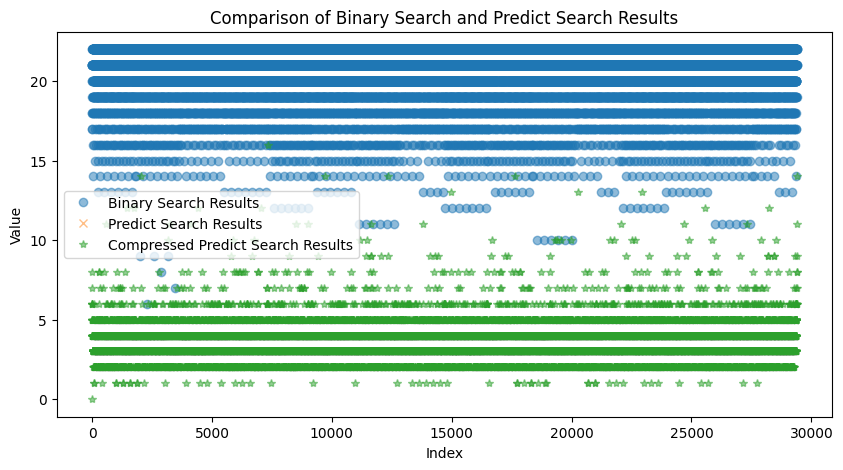

In [40]:
plt.figure(figsize=(10, 5))

# 绘制 binarys 数据
plt.plot(binarys, label='Binary Search Results', marker='o', linestyle='None', alpha=0.5)

# 绘制 predics 数据
plt.plot(predics, label='Predict Search Results', marker='x', linestyle='None', alpha=0.5)

plt.plot(compressPredics, label='Compressed Predict Search Results', marker='*', linestyle='None', alpha=0.5)

# 添加标题和标签
plt.title('Comparison of Binary Search and Predict Search Results')
plt.xlabel('Index')
plt.ylabel('Value')

# 添加图例
plt.legend()

# 显示图表
plt.show()

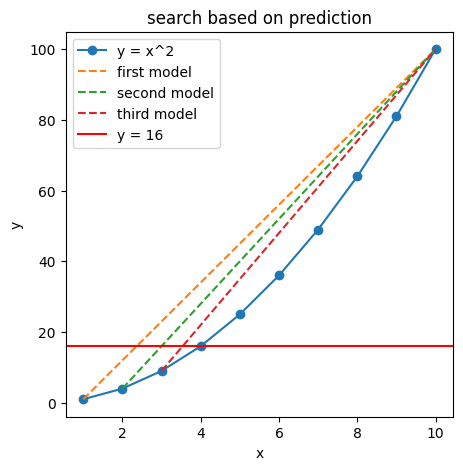

In [21]:
#可视化一次查询过程
plt.figure(figsize=(5, 5))

# 绘制 y = x^2 数据
plt.plot(x, y, label='y = x^2', marker='o')

# 绘制连接首尾元素的直线
plt.plot([x[0], x[-1]], [y[0], y[-1]], label='first model', linestyle='--')
plt.plot([x[1], x[-1]], [y[1], y[-1]], label='second model', linestyle='--')
plt.plot([x[2], x[-1]], [y[2], y[-1]], label='third model', linestyle='--')

plt.axhline(y=16, color='r', linestyle='-', label='y = 16')
# 添加标题和标签
plt.title('search based on prediction')
plt.xlabel('x')
plt.ylabel('y')

# 添加图例
plt.legend()

# 显示图表
plt.show()

predictIndex:  1 predictValue: 1
predictIndex:  1 predictValue: 2
predictIndex:  1 predictValue: 20


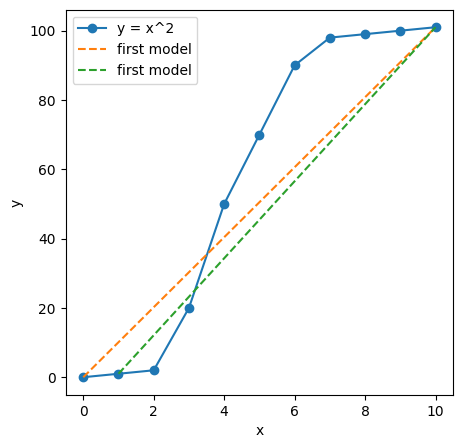

In [8]:
x = [0,1,2,3,4,5,6,7,8,9,10]
y = [0,1,2, 20, 50, 70, 90, 98, 99, 100, 101]
compressPredictSearch(y,20, 0)


plt.figure(figsize=(5, 5))
plt.plot(x, y, label='y = x^2', marker='o')
plt.xlabel('x')
plt.ylabel('y')

plt.plot([x[0], x[-1]], [y[0], y[-1]], label='first model', linestyle='--')
plt.plot([x[1], x[-1]], [y[1], y[-1]], label='first model', linestyle='--')
# 添加图例
plt.legend()

# 显示图表
plt.show()